#### Experiment 2
- Saarbrucken(Near bahnhof region)

In [126]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
import glob

#reading files
import rasterio
import rioxarray
import xarray as xr
from PIL import Image
import warnings
warnings.filterwarnings('ignore')


In [6]:
### Quick look at the data
img_path = glob.glob("/home/akansh-i2sc/Desktop/Research@societal/data_parking_exp_2/Saar_Parking/*/*/*.tif")
print(len(img_path))

img = rioxarray.open_rasterio(img_path[0])

500


In [15]:
## delete images with different shape
del_img = []
for i in img_path:
    img = rioxarray.open_rasterio(i)
    if img.shape != (4, 525, 554):
        del_img.append(i)

In [18]:
len(del_img)
# remove images with different shape from the list img_path
for i in del_img:
    img_path.remove(i)

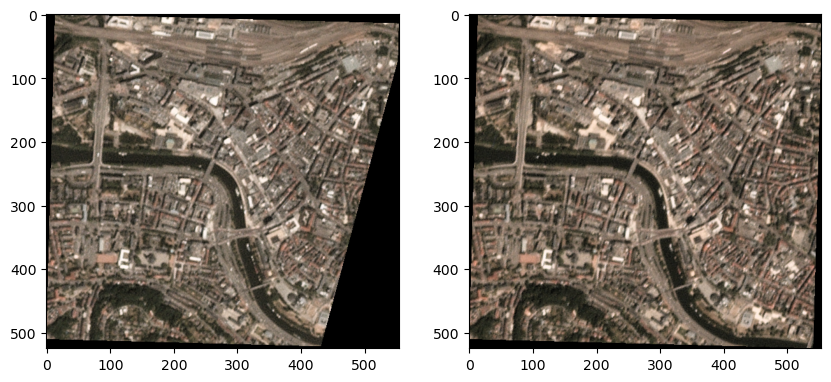

In [23]:
#plot the first two images
img1 = rioxarray.open_rasterio(img_path[0])
img2 = rioxarray.open_rasterio(img_path[1])
plt.figure(figsize=(10,10))
plt.subplot(1,2,1)
plt.imshow(img1.data[0:3].transpose(1, 2, 0))
img
plt.subplot(1,2,2)
plt.imshow(img2.data[0:3].transpose(1, 2, 0))

#note: some images are having artifacts

In [27]:
np.max(img2.data)

255

In [28]:
# count the number of black pixels in each image
black_pixels = []
for i in img_path:
    img = rioxarray.open_rasterio(i)
    black_pixels.append(np.count_nonzero(img.data[0:3].transpose(1, 2, 0) == 0))

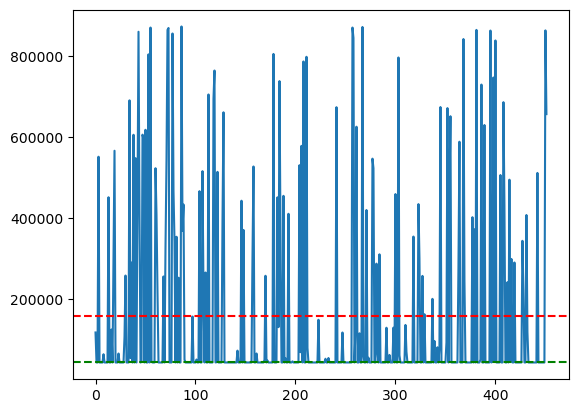

In [33]:
# plot the black pixels and plot mean and median line
plt.plot(black_pixels)
plt.axhline(np.mean(black_pixels), color='r', linestyle='--')
plt.axhline(np.median(black_pixels), color='g', linestyle='--')


In [38]:
# create two list, one where we remove images having black pixels greater than mean and other where we remove images having black pixels greater than median
img_path_mean = []
img_path_median = []
for i in range(len(img_path)):
    if black_pixels[i] < np.mean(black_pixels):
        img_path_mean.append(img_path[i])
    if black_pixels[i] <= np.median(black_pixels):
        img_path_median.append(img_path[i])
#delete the images from the list

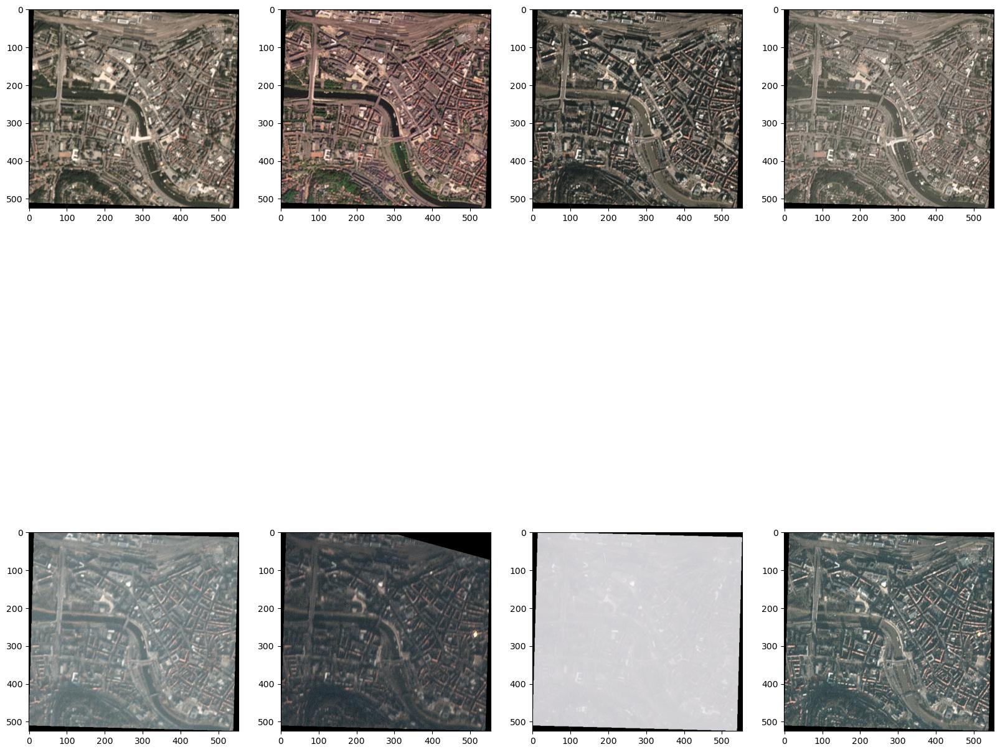

In [46]:
#plot random 8 images from the img_path_mean
import random
random.seed(42)
random_img = random.sample(img_path_mean, 8)
plt.figure(figsize=(20,20))
for i in range(8):
    plt.subplot(2,4,i+1)
    img = rioxarray.open_rasterio(random_img[i])
    plt.imshow(img.data[0:3].transpose(1, 2, 0))
    

In [48]:
print("Number of images after removing images with black pixels greater than mean: ", len(img_path_mean))

Number of images after removing images with black pixels greater than mean:  347


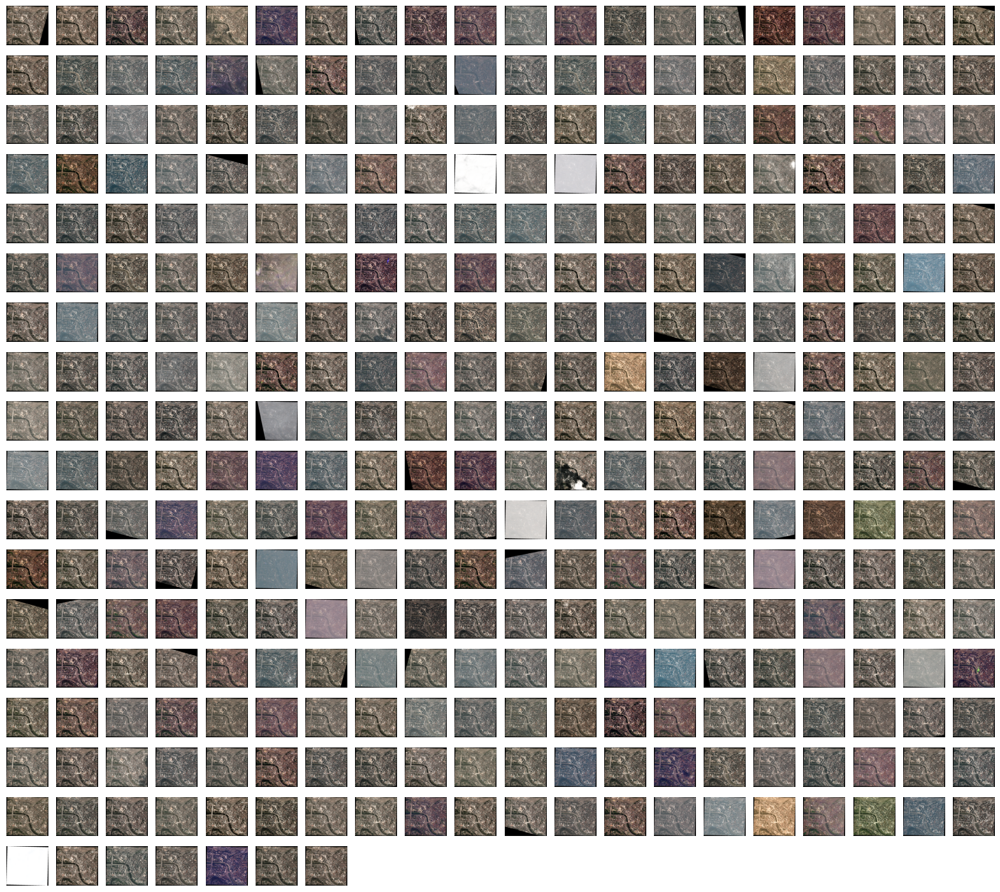

In [52]:
#plot all images from the img_path_mean in small tiles
plt.figure(figsize=(20,20))
for i in range(len(img_path_mean)):
    plt.subplot(20,20,i+1)
    img = rioxarray.open_rasterio(img_path_mean[i])
    plt.imshow(img.data[0:3].transpose(1, 2, 0))
    plt.axis('off')


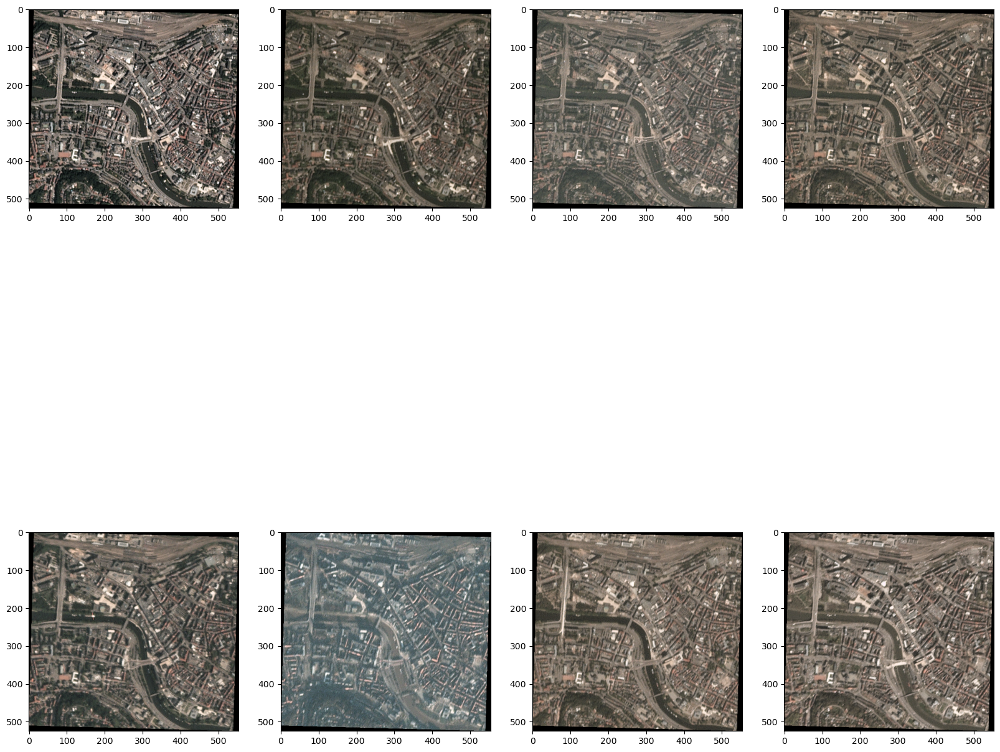

In [47]:
#plot random 8 images from the img_path_median
import random
random.seed(42)
random_img = random.sample(img_path_median, 8)
plt.figure(figsize=(20,20))
for i in range(8):
    plt.subplot(2,4,i+1)
    img = rioxarray.open_rasterio(random_img[i])
    plt.imshow(img.data[0:3].transpose(1, 2, 0))


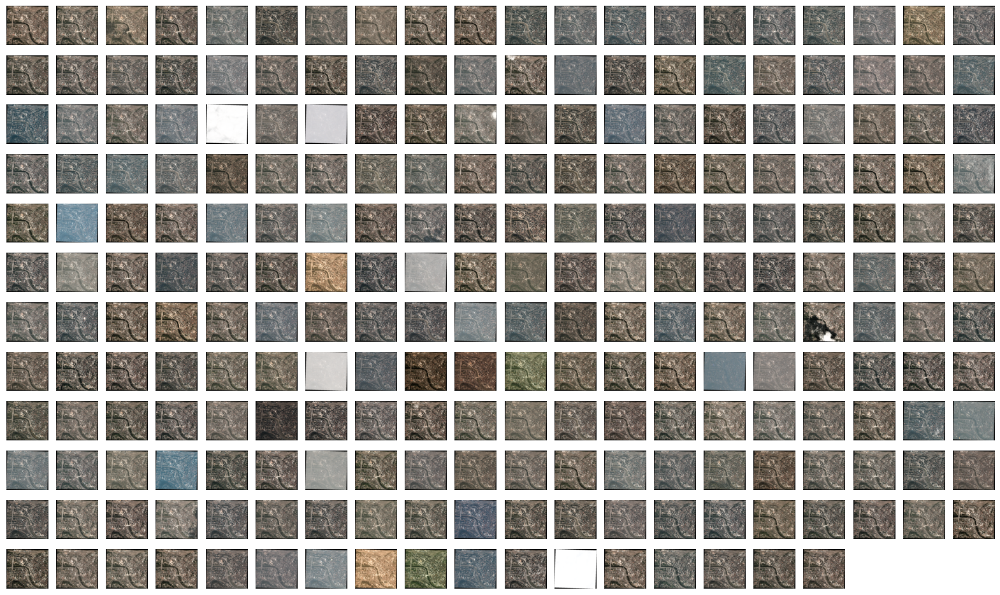

In [51]:
#plot all images from the img_path_median in small tiles
plt.figure(figsize=(20,20))
for i in range(len(img_path_median)):
    plt.subplot(20,20,i+1)
    img = rioxarray.open_rasterio(img_path_median[i])
    plt.imshow(img.data[0:3].transpose(1, 2, 0))
    plt.axis('off')


In [49]:
print("Number of images after removing images with black pixels greater than median: ", len(img_path_median))

Number of images after removing images with black pixels greater than median:  237


#### Observation: 
- Medain data seems more reliable but more strict!

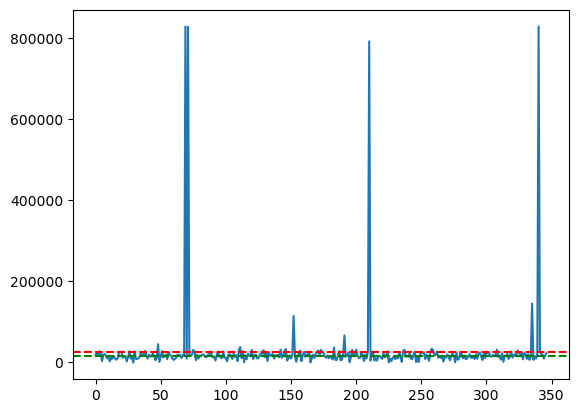

In [62]:
#count the number of white pixels in each image in img_path_median and  img_path_mean
white_pixels_mean = []
for i in img_path_mean:
    img = rioxarray.open_rasterio(i)
    white_pixels_mean.append(np.count_nonzero(img.data[0:3].transpose(1, 2, 0) >= 200))

white_pixels_median = []
for i in img_path_median:
    img = rioxarray.open_rasterio(i)
    white_pixels_median.append(np.count_nonzero(img.data[0:3].transpose(1, 2, 0) >= 200))

#plot the white pixels and plot mean and median line
plt.plot(white_pixels_mean)
plt.axhline(np.mean(white_pixels_mean), color='r', linestyle='--')
plt.axhline(np.median(white_pixels_mean), color='g', linestyle='--')


In [63]:
# remove images having white pixels more than mean from img_path_mean
img_path_mean_white = []
for i in range(len(img_path_mean)):
    if white_pixels_mean[i] < np.mean(white_pixels_mean):
        img_path_mean_white.append(img_path_mean[i])
print("Number of images after removing images with white pixels greater than mean: ", len(img_path_mean_white))

Number of images after removing images with white pixels greater than mean:  302


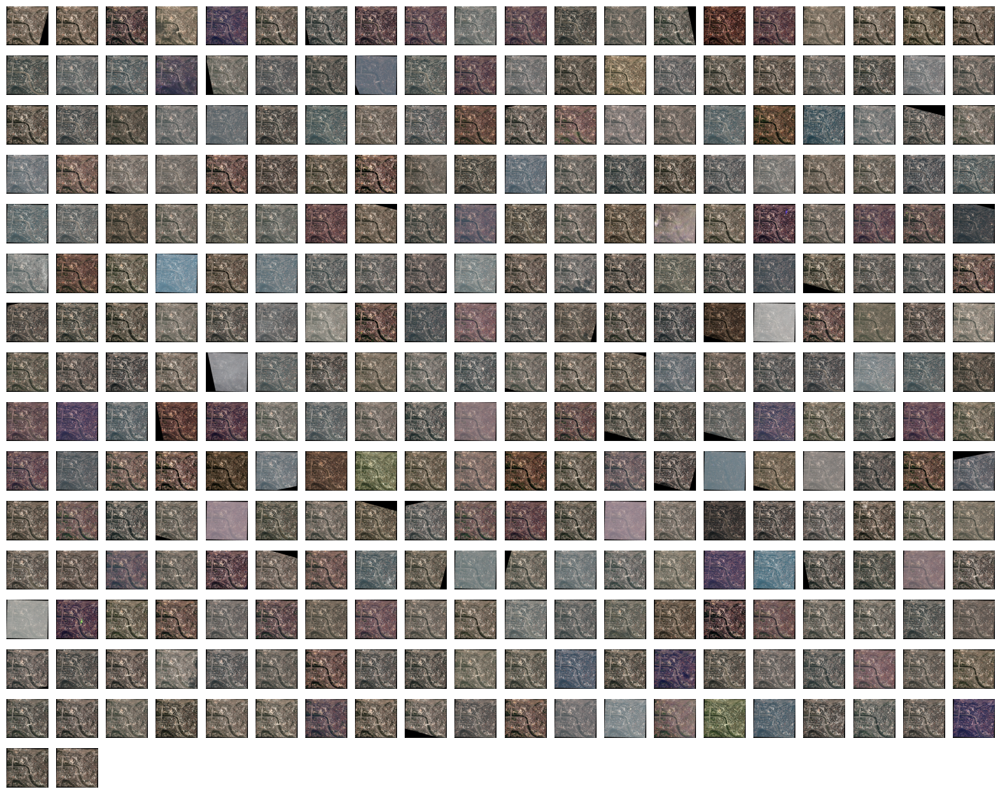

In [64]:
#plot all images from the img_path_mean_white in small tiles
plt.figure(figsize=(20,20))
for i in range(len(img_path_mean_white)):
    plt.subplot(20,20,i+1)
    img = rioxarray.open_rasterio(img_path_mean_white[i])
    plt.imshow(img.data[0:3].transpose(1, 2, 0))
    plt.axis('off')


In [65]:
## remove images having white pixels more than median from img_path_median
# img_path_median_white = []
# for i in range(len(img_path_median)):
#     if white_pixels_median[i] < np.median(white_pixels_median):
#         img_path_median_white.append(img_path_median[i])
# print("Number of images after removing images with white pixels greater than median: ", len(img_path_median_white))

# #plot all images from the img_path_median_white in small tiles
# plt.figure(figsize=(20,20))
# for i in range(len(img_path_median_white)):
#     plt.subplot(20,20,i+1)
#     img = rioxarray.open_rasterio(img_path_median_white[i])
#     plt.imshow(img.data[0:3].transpose(1, 2, 0))
#     plt.axis('off')

Number of images after removing images with white pixels greater than median:  118


Number of images after removing images with white pixels greater than mean:  225


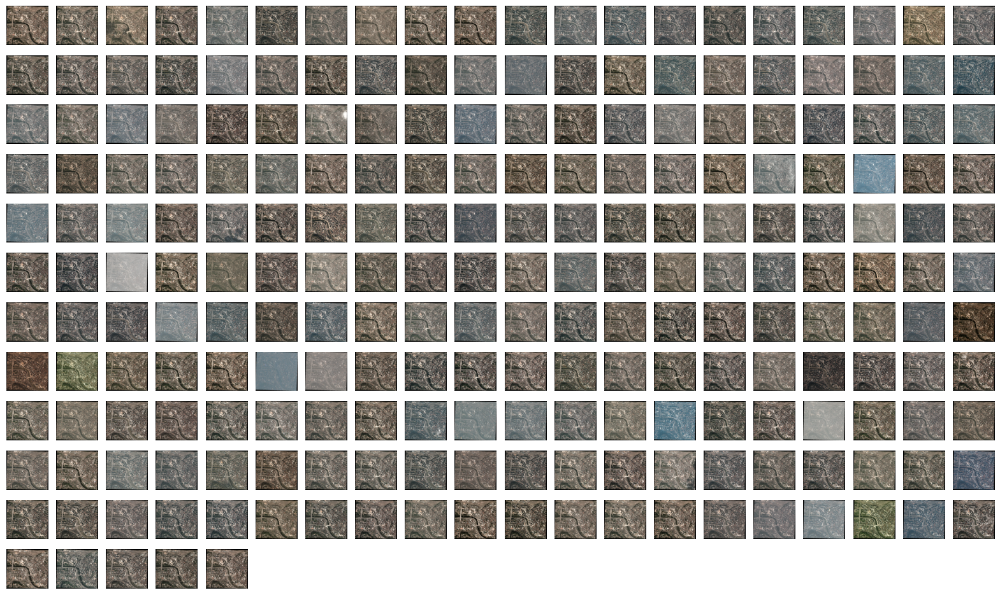

In [67]:
# remove images having white pixels more than mean from img_path_median
img_path_median_white = []
for i in range(len(img_path_median)):
    if white_pixels_median[i] < np.mean(white_pixels_median):
        img_path_median_white.append(img_path_median[i])
print("Number of images after removing images with white pixels greater than mean: ", len(img_path_median_white))

#plot all images from the img_path_median_white in small tiles
plt.figure(figsize=(20,20))
for i in range(len(img_path_median_white)):
    plt.subplot(20,20,i+1)
    img = rioxarray.open_rasterio(img_path_median_white[i])
    plt.imshow(img.data[0:3].transpose(1, 2, 0))
    plt.axis('off')



#### Machine Learning modelling
- Working on img_path_median_white

In [ ]:
# making a dataset with all the images and their labels as day and save it as a csv file
import pandas as pd
import datetime

def find_day(date_string):
    try:
        date = datetime.datetime.strptime(date_string, "%Y-%m-%d")
        day = date.strftime("%A")
        return day
    except ValueError:
        return "Invalid date format. Please provide the date in YYYY-MM-DD format."

df = pd.DataFrame(columns=['image_path', 'day'])
for i in img_path_median_white:
    date_in = i.split('/')[-1].split('_')[0]
    year = date_in[0:4]
    month = date_in[4:6]
    day = date_in[6:8]  
    date_string = f"{year}-{month}-{day}"
    df = df.append({'image_path': i, 'day': find_day(date_string)}, ignore_index=True)

In [100]:
#add another column for the label as weekend or weekday
df['label'] = df['day'].apply(lambda x: 1 if x in ['Saturday', 'Sunday'] else 0)

In [103]:
df.head()

,image_path,day,label
0,/home/akansh-i2sc/Desktop/Research@societal/da...,Wednesday,0
1,/home/akansh-i2sc/Desktop/Research@societal/da...,Thursday,0
2,/home/akansh-i2sc/Desktop/Research@societal/da...,Friday,0
3,/home/akansh-i2sc/Desktop/Research@societal/da...,Sunday,1
4,/home/akansh-i2sc/Desktop/Research@societal/da...,Tuesday,0


In [102]:
df.label.value_counts()

0    153
1     72
Name: label, dtype: int64

In [104]:
df

,image_path,day,label
0,/home/akansh-i2sc/Desktop/Research@societal/da...,Wednesday,0
1,/home/akansh-i2sc/Desktop/Research@societal/da...,Thursday,0
2,/home/akansh-i2sc/Desktop/Research@societal/da...,Friday,0
3,/home/akansh-i2sc/Desktop/Research@societal/da...,Sunday,1
4,/home/akansh-i2sc/Desktop/Research@societal/da...,Tuesday,0
...,...,...,...
220,/home/akansh-i2sc/Desktop/Research@societal/da...,Thursday,0
221,/home/akansh-i2sc/Desktop/Research@societal/da...,Saturday,1
222,/home/akansh-i2sc/Desktop/Research@societal/da...,Monday,0
223,/home/akansh-i2sc/Desktop/Research@societal/da...,Friday,0


In [105]:
### make a machine learning model to predict the label
#split the data into train and test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df['image_path'], df['label'], test_size=0.2, random_state=42)

#make a function to read the image and convert it into a numpy array
def read_image(image_path):
    img = rioxarray.open_rasterio(image_path)
    img = img.data[0:3].transpose(1, 2, 0)
    return img

#make a function to resize the image
def resize_image(image, image_size):
    image = cv2.resize(image.copy(), image_size, interpolation=cv2.INTER_AREA)
    return image

#make a function to preprocess the images and convert them into numpy arrays
def preprocess_image(image_path, desired_size=128):
    img = read_image(image_path)
    img = resize_image(img, (desired_size, desired_size))
    img = img.reshape(-1, desired_size*desired_size*3)
    return img[0]


In [ ]:
#preprocess the train and test images
X_train = np.array([preprocess_image(img) for img in X_train])
X_test = np.array([preprocess_image(img) for img in X_test])

In [128]:
#train multiple models and check their accuracy, AUC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, roc_auc_score

models = {
    "Logistic Regression": LogisticRegression(),
    "Random Forest": RandomForestClassifier(),
    "SVC": SVC()
}

for name, model in models.items():
    model.fit(X_train, y_train)
    print(name + " trained.")

    y_pred = model.predict(X_test)
    print("Accuracy: {:.3f}".format(accuracy_score(y_test, y_pred)))
    print("AUC: {:.3f}".format(roc_auc_score(y_test, y_pred)))
    print("")

Logistic Regression trained.
Accuracy: 0.822
AUC: 0.764

Random Forest trained.
Accuracy: 0.756
AUC: 0.684

SVC trained.
Accuracy: 0.644
AUC: 0.500

